# PCA vs Feature Agglomeration

In [1]:
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from sklearn.linear_model import LinearRegression
from sklearn.cluster import FeatureAgglomeration
from IPython.display import HTML

np.random.seed(47); plt.style.use('dark_background')
warnings.filterwarnings('ignore')
plt.rc('axes', titlesize=15, labelsize=20, labelpad=5)
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)
plt.rc('legend', fontsize=12)
plt.rc('animation', embed_limit=500)

# Generate synthetic data
f1 = np.random.normal(1, 5, 1000)
f2 = 0.5 * f1 + 0.5 * np.random.normal(2, 5, 1000)
f3 = np.random.normal(3, 5, 1000)
f4 = (
    0.6 * f3 + 0.1 * f2 + 
    0.3 * np.random.normal(4, 5, 1000)
)

df = pd.DataFrame(dict(
    feature_1=f1,
    feature_2=f2,
    feature_3=f3,
    feature_4=f4
))


df.sample(1)

,feature_1,feature_2,feature_3,feature_4
536,-11.447977,-3.862544,-5.631364,-3.024381


In [2]:
combinations = [
    ('feature_1', 'feature_3', 'feature_2'),
    ('feature_3', 'feature_4', 'feature_1'),
    ('feature_3', 'feature_1', 'feature_4'),
    ('feature_4', 'feature_3', 'feature_2')
]

# Function to transform the feature name 
def transform_feature_name(feature):
    """feature_1 -> Feature"""
    p1, p2 = feature.split('_')
    return f"{p1.capitalize()}-{p2}"

# Function to display the modeled relationship
def format_title(features):
    """For formatting plot title."""
    ffs = [
        transform_feature_name(f) for f in features
    ]
    if len(ffs) > 1:
        return f"{ffs[-1]} ~ {' + '.join(ffs[:-1])}"
    else:
        return ffs[0]

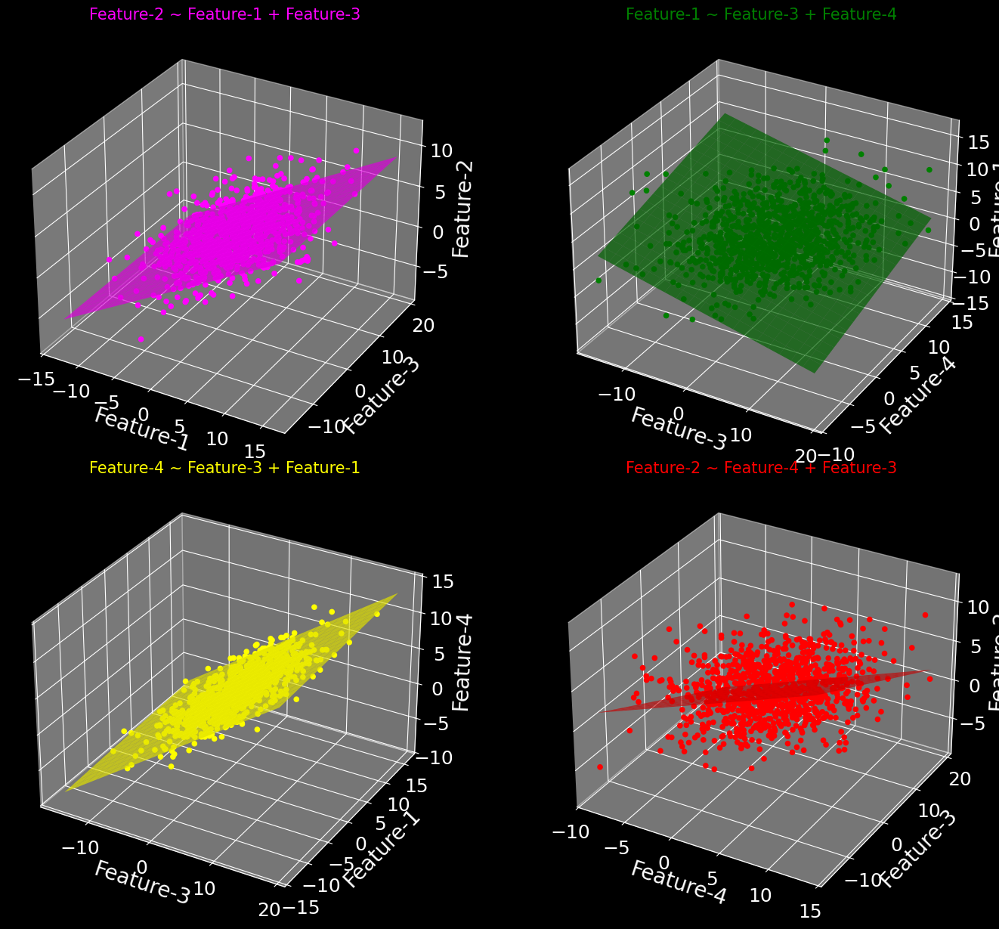

In [3]:
# Colors for each combination
colors = ['magenta', 'green', 'yellow', 'red']

# Define the figure for 4 subplots
fig = plt.figure(figsize=(16, 12))
axes = [
    fig.add_subplot(2, 2, i+1, projection='3d') 
    for i in range(4)
]

scatters = []
for i, (x, y, z) in enumerate(combinations):
    scatter = axes[i].scatter(df[x], df[y], df[z], 
                              c=colors[i], marker='o', 
                              alpha=1)
    
    axes[i].set_xlabel(transform_feature_name(x))
    axes[i].set_ylabel(transform_feature_name(y))
    axes[i].set_zlabel(transform_feature_name(z))
    
    axes[i].set_title(
        format_title([x, y, z]), 
        color=colors[i]
    )

    # Train linear regression model
    X = df[[x, y]]
    y_val = df[z]

    # Initialize the model and fit it
    model = LinearRegression()
    model.fit(X, y_val)

    # Create a grid to plot the hyperplane
    x_range = np.linspace(df[x].min(), df[x].max(), 20)
    y_range = np.linspace(df[y].min(), df[y].max(), 20)
    xx, yy = np.meshgrid(x_range, y_range)

    # Predict z values using the model
    zz = (
        model.predict(np.c_[xx.ravel(), yy.ravel()])
        .reshape(xx.shape)
    )
    # Plot the hyperplane
    axes[i].plot_surface(xx, yy, zz, 
                         color=colors[i], alpha=0.7)

    scatters.append(scatter)
plt.subplots_adjust(wspace=0, hspace=0.1)
plt.tight_layout(pad=0)
plt.show()

In [4]:
def animate(frame):
    for ax in axes:
        # Add some padding to ensure the view is spacious
        xlim = ax.get_xlim()
        ylim = ax.get_ylim()
        zlim = ax.get_zlim()

        padding = 0.1
        ax.set_xlim([xlim[0] - padding, xlim[1] + padding])
        ax.set_ylim([ylim[0] - padding, ylim[1] + padding])
        ax.set_zlim([zlim[0] - padding, zlim[1] + padding])
        ax.view_init(elev=30, azim=frame)
        ax.grid(False)
        ax.set_axis_off()
        
# Cluster features using FeatureAgglomeration
# You can also specify the distance threshold 
fa = FeatureAgglomeration(n_clusters=2) 
fa_labels = fa.fit_transform(df.values)
print(
    f"""First cluster: {
    df.columns[fa.labels_ == 0].tolist()
    }
Second cluster: {
df.columns[fa.labels_ == 1].tolist()
}"""
)

First cluster: ['feature_1', 'feature_2']
Second cluster: ['feature_3', 'feature_4']


In [6]:
ani = FuncAnimation(fig, animate, 
                    frames=np.arange(0, 360, 2), 
                    interval=5)
HTML(ani.to_jshtml())

| **Aspect**             | **Feature Agglomeration**           | **PCA**                           |
|------------------------|-------------------------------------|-----------------------------------|
| **Purpose**            | Groups similar features             | Transforms features to PCs |
| **Interpretability**   | More interpretable                  | Less interpretable                |
| **Nonlinearity**       | Can handle nonlinear relationships     | Linear relationships only         |
| **Complexity**         | Can be computationally expensive    | More computationally efficient    |
| **Use Case**           | High number of correlated features (creating feature sets for AD)      | Reducing dimensionality with variance retention |

In [5]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
pca = PCA(n_components=0.95)
pca.fit(StandardScaler().fit_transform(df.values))
m, n = pca.components_.shape
loadings_df = pd.DataFrame(
   pca.components_, 
   columns=[f'Feature {i+1}' for i in range(n)], 
   index=[f'PC{i+1}' for i in range(m)]
)
print("PCA Loadings:")
print(loadings_df)
explained_variance = pca.explained_variance_ratio_
print("\nExplained Variance by each PC:")
print(explained_variance)

PCA Loadings:
     Feature 1  Feature 2  Feature 3  Feature 4
PC1  -0.088938  -0.058989   0.706076   0.700048
PC2   0.700179   0.704659   0.040405   0.107578
PC3   0.707200  -0.698756   0.089768  -0.059574

Explained Variance by each PC:
[0.47289268 0.42807882 0.07267809]
